# Aranet Remote Sensing Project

In [1]:
import pandas as pd
# import numpy as np
import json
import os
import re

import sqlalchemy as sql
from sqlalchemy import create_engine, MetaData, Table, Column, Integer, String, Text, delete, insert, DateTime, Float, Boolean, select, distinct, inspect, Time
from datetime import datetime

In [2]:
# Set the DATABASE_URL environment variable
DATABASE_URL = os.environ.get("DATABASE_URL")
if DATABASE_URL.startswith("postgres://"):
    DATABASE_URL = DATABASE_URL.replace("postgres://", "postgresql://", 1)

# Create the database engine
engine = sql.create_engine(DATABASE_URL)

metadata = MetaData()

In [3]:
# Query
def query(sql_query):
    data = pd.read_sql_query(sql_query, engine)
    data.index += 1
    return data

q = """
SELECT *
FROM aranet_lecture_data
"""

aranetExp = query(q)

q = """
SELECT *
FROM aranet4
"""

aranet4 = query(q)

In [4]:
aranetExp.head()

,id,date,time,door1,door2,hvac,subject_count
1,2,2024-03-13 13:04:41,13:04:41,closed,open,on,17
2,3,2024-03-13 13:07:05,13:07:05,closed,open,on,16
3,4,2024-03-13 13:07:52,13:07:52,closed,open,on,17
4,5,2024-03-13 13:08:20,13:08:20,closed,open,off,17
5,6,2024-03-13 13:19:03,13:19:03,closed,open,on,17


In [5]:
aranet4.head()

,Carbon dioxide(ppm),Temperature(°F),Relative humidity(%),Atmospheric pressure(hPa),Date,Time
1,1014,77.8,47.0,1007.3,01/12/2024,16:08:15
2,884,78.5,46.0,1007.3,01/12/2024,16:09:15
3,914,79.7,43.0,1007.4,01/12/2024,16:10:15
4,906,79.7,42.0,1007.2,01/12/2024,16:11:15
5,896,79.3,41.0,1007.3,01/12/2024,16:12:15


## Plotly Dash Components
We can explore plotly dash components in a jupyter notebook. This is helpful when exploring the basics and figuring out how to work with some basic callbacks. Our two main types of dash components are `dash core components (dcc)` and `dash bootstrap components(dbc)`.

In [6]:
# Dash Modules from Plotly Dash
from dash import Dash, dcc, html, Input, Output, State, callback, dash_table, callback_context, no_update
from dash.dependencies import ALL
from dash.exceptions import PreventUpdate
import dash_bootstrap_components as dbc

My personal preference is two define my components separately and then put them together in the layout by their variable or functions names. This helps organize the code. For instance if we want to build a graph with callback functionality which reacts to defined components, we can do as follows: here we construct a date range and time slider. When the time slide is at full length it will display 24 hours of every day continuously for the given data range. Supoose we want to examine the hours of 9 to 10 AM for each business day over a two week period with each subgraph being appended, then we can change the time-span on the scale and select the given days. We will do that now using `aranet4` `Date` and `Time` features.

In [7]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 6 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   Carbon dioxide(ppm)        83432 non-null  int64  
 1   Temperature(°F)            83432 non-null  float64
 2   Relative humidity(%)       83379 non-null  float64
 3   Atmospheric pressure(hPa)  80910 non-null  float64
 4   Date                       83432 non-null  object 
 5   Time                       83432 non-null  object 
dtypes: float64(3), int64(1), object(2)
memory usage: 3.8+ MB


In [70]:
# Ensure the Date and Time columns are of type string
aranet4['Date'] = aranet4['Date'].astype(str)
aranet4['Time'] = aranet4['Time'].astype(str)

# Combine Date and Time into a single datetime column
aranet4['Datetime'] = pd.to_datetime(aranet4['Date'] + ' ' + aranet4['Time'])
aranet4['Datetime'].head()

Datetime
2024-01-12 16:08:15   2024-01-12 16:08:15
2024-01-12 16:09:15   2024-01-12 16:09:15
2024-01-12 16:10:15   2024-01-12 16:10:15
2024-01-12 16:11:15   2024-01-12 16:11:15
2024-01-12 16:12:15   2024-01-12 16:12:15
Name: Datetime, dtype: datetime64[ns]

In [9]:
date_range = dcc.DatePickerRange()
time_slider = dcc.Slider()

In [10]:
import plotly.express as px

fig = px.line(aranet4, x='Datetime', y='Relative humidity(%)', title='Relative Humidity Over Time')
fig.show()


In [11]:
import pandas as pd
from dash import Dash, dcc, html, Input, Output, State
import dash_bootstrap_components as dbc
import plotly.express as px

panel_style = {
    'border': '1px solid #ddd',
    'borderRadius': '15px',
    'padding': '20px',
    'marginBottom': '15px',
    'backgroundColor': '#f8f9fa'
}
# Create a Dash app
app = Dash(__name__, external_stylesheets=[dbc.themes.BOOTSTRAP])

# Define external components
date_range = dcc.DatePickerRange(
    id='date-range',
    min_date_allowed=aranet4['Datetime'].min().date(),
    max_date_allowed=aranet4['Datetime'].max().date(),
    start_date=aranet4['Datetime'].min().date(),
    end_date=aranet4['Datetime'].max().date()
)

time_slider = dcc.RangeSlider(
    id='time-slider',
    min=0,
    max=23,
    value=[0, 23],
    marks={i: f"{i}:00" for i in range(24)},
    step=1,
    pushable=1
)

feature_dropdown = dcc.Dropdown(
    id="column-dropdown",
    options=[{"label": col, "value": col} for col in aranet4.columns if col not in ['Date', 'Time', 'Datetime']],
    value="Carbon dioxide(ppm)"
)

app.layout = html.Div([
    dbc.Row([
        dbc.Col(html.Div([
            html.Label("Select Date Range:"),
            date_range  # Assuming this is already defined with the correct attributes
        ]), width=3, lg=3),  # Adjust the width as necessary
        dbc.Col(html.Div([
            html.Label("Select Time Range:"),
            time_slider  # Assuming this is already defined with the correct attributes
        ]), width=9, lg=9)  # Adjust the width as necessary
    ], justify='center'),
    html.H1("Aranet4 Data Visualization", className="mb-5"),
    dbc.Row([
        dbc.Col(html.Div([
            html.Label("Select a column to plot:"),
            feature_dropdown  # Assuming this is already defined with the correct attributes
        ]), width=12, lg=12)  # Adjust the width as necessary
    ], justify='center'),
    dbc.Row([
        dbc.Col(dcc.Graph(id="graph"), width=12)  # Ensure the graph takes the full width
    ])
])



@app.callback(
    Output("graph", "figure"),
    [Input("column-dropdown", "value"),
     Input("date-range", "start_date"),
     Input("date-range", "end_date"),
     Input("time-slider", "value")]
)
def update_graph(selected_column, start_date, end_date, time_range):
    # Convert start_date and end_date to pandas Timestamps
    start_timestamp = pd.to_datetime(start_date)
    end_timestamp = pd.to_datetime(end_date)

    # Filter the dataframe based on the date range and time slider values
    filtered_df = aranet4[
        (aranet4['Datetime'].dt.floor('D') >= start_timestamp) &
        (aranet4['Datetime'].dt.floor('D') <= end_timestamp) &
        (aranet4['Datetime'].dt.hour >= time_range[0]) &
        (aranet4['Datetime'].dt.hour <= time_range[1])
    ]
    
    # Create the figure using the filtered dataframe
    fig = px.line(filtered_df, x="Datetime", y=selected_column, title=f"{selected_column} over Time")
    return fig




# Run the app in Jupyter
app.run_server(mode="inline")




In [12]:
import pandas as pd
from dash import Dash, dcc, html, Input, Output
import dash_bootstrap_components as dbc
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Assuming 'aranet4' is your DataFrame

# Create a Dash app
app = Dash(__name__, external_stylesheets=[dbc.themes.BOOTSTRAP])

# Define the layout of the app
app.layout = html.Div([
    dbc.Row([
        dbc.Col(html.Div([
            html.Label("Select Date Range:"),
            date_range  # Assuming this is already defined with the correct attributes
        ]), width=3, lg=3),  # Adjust the width as necessary
        dbc.Col(html.Div([
            html.Label("Select Time Range:"),
            time_slider  # Assuming this is already defined with the correct attributes
        ]), width=9, lg=9)  # Adjust the width as necessary
    ], justify='center'),
    html.H1("Aranet4 Data Visualization", className="mb-5"),
    dbc.Row([
        dbc.Col(html.Div([
            html.Label("Select a column to plot:"),
            feature_dropdown  # Assuming this is already defined with the correct attributes
        ]), width=12, lg=12)  # Adjust the width as necessary
    ], justify='center'),
    dbc.Row([
        dbc.Col(dcc.Graph(id="time_series_graph"), width=12)  # Time series graph
    ]),
    dbc.Row([
        dbc.Col(dcc.Graph(id="histogram_graph"), width=6),  # Histogram
        dbc.Col(dcc.Graph(id="boxplot_graph"), width=6)  # Boxplot
    ])
])

@app.callback(
    [Output("time_series_graph", "figure"),
     Output("histogram_graph", "figure"),
     Output("boxplot_graph", "figure")],
    [Input("column-dropdown", "value"),
     Input("date-range", "start_date"),
     Input("date-range", "end_date"),
     Input("time-slider", "value")]
)
def update_graphs(selected_column, start_date, end_date, time_range):
    # Filter the dataframe based on the date range and time slider values
    filtered_df = aranet4[
        (aranet4['Datetime'] >= pd.to_datetime(start_date)) &
        (aranet4['Datetime'] <= pd.to_datetime(end_date)) &
        (aranet4['Datetime'].dt.hour >= time_range[0]) &
        (aranet4['Datetime'].dt.hour <= time_range[1])
    ]

    # Time series plot
    time_series_fig = px.line(filtered_df, x='Datetime', y=selected_column, title=f'{selected_column} over Time')

    # Histogram
    histogram_fig = px.histogram(filtered_df, x=selected_column, title=f'Distribution of {selected_column}')

    # Boxplot
    boxplot_fig = px.box(filtered_df, y=selected_column, title=f'Box Plot of {selected_column}')

    return time_series_fig, histogram_fig, boxplot_fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


In [13]:
# Function to categorize CO2 quality
def categorize_co2(co2_value):
    if co2_value < 1000:
        return 'Optimal'
    elif 1000 <= co2_value <= 1400:
        return 'Average'
    else:
        return 'Unhealthy'

# Apply the function to the 'Carbon dioxide(ppm)' column to create a new 'CO2Quality' feature
aranet4['CO2Quality'] = aranet4['Carbon dioxide(ppm)'].apply(categorize_co2)

Find intervals of largest 3, 5, 10, 30, and 60 minute change. Shorter intervals of rapid onset change are indicators for environment change. Can we predict a change in environment as well as changes in environmental conditions. What is the distribution of the 1, 3, 5, 10, 30,  and 60 minute CO2 ppm differences and averages (use bins).

In [14]:
def categorize_rhumidity(rh_value):
    if rh_value < 30.0:
        return 'Low'
    elif 30.0 <= rh_value <= 50.0:
        return 'Ideal'
    elif rh_value > 50.0:
        return 'High'

aranet4['RHQuality'] = aranet4['Relative humidity(%)'].apply(categorize_rhumidity)

In [15]:
# Dew Point calculation
def dew_point(temp, rh):
    """
    Calculate dew point in °F given temperature in °F and relative humidity in %.
    """
    temp_c = (temp - 32) * 5 / 9  # Convert temperature to °C
    rh_decimal = rh / 100  # Convert relative humidity to decimal
    dew_point_c = temp_c - ((100 - rh_decimal) / 5)
    dew_point_f = (dew_point_c * 9 / 5) + 32  # Convert dew point back to °F
    return dew_point_f

# Heat Index calculation
def heat_index(temp, rh):
    """
    Calculate heat index in °F given temperature in °F and relative humidity in %.
    """
    temp_c = (temp - 32) * 5 / 9  # Convert temperature to °C
    rh_decimal = rh / 100  # Convert relative humidity to decimal

    heat_index_f = (
        -42.379
        + 2.04901523 * temp
        + 10.14333127 * rh
        - 0.22475541 * temp * rh
        - 6.83783e-03 * temp ** 2
        - 5.481717e-02 * rh ** 2
        + 1.22874e-03 * temp ** 2 * rh
        + 8.5282e-04 * temp * rh ** 2
        - 1.99e-06 * temp ** 2 * rh ** 2
    )

    return heat_index_f

# AQI calculation (example function, replace with actual AQI calculation)
def aqi(co2_level):
    """
    Calculate AQI based on CO2 level.
    """
    # Example calculation for AQI based on CO2 level
    if co2_level <= 1000:
        return 0
    elif co2_level <= 2000:
        return 50
    elif co2_level <= 5000:
        return 100
    else:
        return 150

# Create new columns for dew point, heat index, and AQI
aranet4['Dew Point(°F)'] = dew_point(aranet4['Temperature(°F)'], aranet4['Relative humidity(%)'])
aranet4['Heat Index(°F)'] = heat_index(aranet4['Temperature(°F)'], aranet4['Relative humidity(%)'])
aranet4['AQI'] = aranet4['Carbon dioxide(ppm)'].apply(aqi)

aranet4.head()  # Display the first few entries of the new column for verification

,Carbon dioxide(ppm),Temperature(°F),Relative humidity(%),Atmospheric pressure(hPa),Date,Time,Datetime,CO2Quality,RHQuality,Dew Point(°F),Heat Index(°F),AQI
1,1014,77.8,47.0,1007.3,01/12/2024,16:08:15,2024-01-12 16:08:15,Average,Ideal,41.9692,78.965210,50
2,884,78.5,46.0,1007.3,01/12/2024,16:09:15,2024-01-12 16:09:15,Optimal,Ideal,42.6656,79.353810,0
3,914,79.7,43.0,1007.4,01/12/2024,16:10:15,2024-01-12 16:10:15,Optimal,Ideal,43.8548,79.961414,0
4,906,79.7,42.0,1007.2,01/12/2024,16:11:15,2024-01-12 16:11:15,Optimal,Ideal,43.8512,79.882508,0
5,896,79.3,41.0,1007.3,01/12/2024,16:12:15,2024-01-12 16:12:15,Optimal,Ideal,43.4476,79.541151,0


The calculation for the heat index comes from the National Weather Service (NWS) in the United States. The formula is an approximation and is used to estimate how hot the air "feels" to the human body when relative humidity is taken into account along with the actual air temperature. Here is the formula for calculating the heat index:

$\[ HI = c_1 + c_2T + c_3RH + c_4T \cdot RH + c_5T^2 + c_6RH^2 + c_7T^2 \cdot RH + c_8T \cdot RH^2 + c_9T^2 \cdot RH^2 \]$

where:

- $\( HI \)$ is the heat index in Fahrenheit.
- \( T \) is the air temperature in Fahrenheit.
- \( RH \) is the relative humidity as a decimal (e.g., 60% relative humidity would be 0.6).
- \( c_1, c_2, \ldots, c_9 \) are coefficients specific to the formula.

As for the AQI levels used in the example, they are just placeholders for demonstration purposes. The actual AQI levels and breakpoints for CO2 may vary based on local air quality standards and guidelines. You should consult official air quality monitoring agencies or organizations (such as the Environmental Protection Agency in the US or similar agencies in your country) for the most accurate and up-to-date AQI levels for CO2.

In [16]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 12 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Carbon dioxide(ppm)        83432 non-null  int64         
 1   Temperature(°F)            83432 non-null  float64       
 2   Relative humidity(%)       83379 non-null  float64       
 3   Atmospheric pressure(hPa)  80910 non-null  float64       
 4   Date                       83432 non-null  object        
 5   Time                       83432 non-null  object        
 6   Datetime                   83432 non-null  datetime64[ns]
 7   CO2Quality                 83432 non-null  object        
 8   RHQuality                  83379 non-null  object        
 9   Dew Point(°F)              83379 non-null  float64       
 10  Heat Index(°F)             83379 non-null  float64       
 11  AQI                        83432 non-null  int64         
dtypes: d

Find intervals of largest 3, 5, 10, 30, and 60 minute change. Shorter intervals of rapid onset change are indicators for environment change. Can we predict a change in environment as well as changes in environmental conditions. What is the distribution of the 1, 3, 5, 10, 30,  and 60 minute CO2 ppm differences and averages (use bins).

In [17]:
# Assuming 'aranet4' DataFrame is defined and has a 'Carbon dioxide(ppm)' column.
# The following code should be run in your local environment where 'aranet4' is available.

# Calculate the minute-to-minute difference in CO2 levels
aranet4['CO2_diff'] = aranet4['Carbon dioxide(ppm)'].diff().fillna(0).astype('int64')

# Create a new DataFrame for the minute-to-minute CO2 difference
co2_diff_df = aranet4[['Datetime', 'CO2_diff']].copy()

# Showing the first few rows of the new DataFrame and the data type
print(co2_diff_df.head())
print(co2_diff_df.dtypes)



             Datetime  CO2_diff
1 2024-01-12 16:08:15         0
2 2024-01-12 16:09:15      -130
3 2024-01-12 16:10:15        30
4 2024-01-12 16:11:15        -8
5 2024-01-12 16:12:15       -10
Datetime    datetime64[ns]
CO2_diff             int64
dtype: object


In [18]:
import plotly.express as px

# Assuming the 'CO2_diff' column exists in your 'aranet4' DataFrame
# and contains the minute-to-minute CO2 difference as integer values

# Create the histogram of the CO2_diff distribution
fig = px.histogram(aranet4, x='CO2_diff', nbins=int(aranet4['CO2_diff'].max() - aranet4['CO2_diff'].min()),
                   title='Distribution of CO2 Differences',
                   labels={'CO2_diff': 'CO2 Difference (ppm)'})

# Show the figure
fig.show()


In [19]:
import plotly.express as px

# Assuming the 'CO2_diff' column exists in your 'aranet4' DataFrame
# and 'Datetime' is the column of datetime objects

# Create the time series plot of the CO2 differences
fig = px.line(aranet4, x='Datetime', y='CO2_diff',
              title='Time Series of Minute-to-Minute CO2 Differences',
              labels={'CO2_diff': 'CO2 Difference (ppm)', 'Datetime': 'Time'})

# Show the figure
fig.show()


In [20]:
# Define a function to calculate the 5-minute moving average for CO2 levels
def calculate_moving_average(dataframe, column_name, window_size=5):
    return dataframe[column_name].rolling(window=window_size, min_periods=1).mean()

# Apply the function to the 'Carbon dioxide(ppm)' column to create a new 'CO2_5min_avg' feature
aranet4['CO2_3min_avg'] = calculate_moving_average(aranet4, 'Carbon dioxide(ppm)', window_size=3)
aranet4['CO2_5min_avg'] = calculate_moving_average(aranet4, 'Carbon dioxide(ppm)', window_size=5)
aranet4['CO2_10min_avg'] = calculate_moving_average(aranet4, 'Carbon dioxide(ppm)', window_size=10)
aranet4['CO2_15min_avg'] = calculate_moving_average(aranet4, 'Carbon dioxide(ppm)', window_size=15)
aranet4['CO2_30min_avg'] = calculate_moving_average(aranet4, 'Carbon dioxide(ppm)', window_size=30)
# Display the first few rows of the 'aranet4' DataFrame to verify the new column
aranet4[['Datetime', 'Carbon dioxide(ppm)', 'CO2_3min_avg', 'CO2_5min_avg', 'CO2_10min_avg', 'CO2_15min_avg', 'CO2_30min_avg']].head()

,Datetime,Carbon dioxide(ppm),CO2_3min_avg,CO2_5min_avg,CO2_10min_avg,CO2_15min_avg,CO2_30min_avg
1,2024-01-12 16:08:15,1014,1014.000000,1014.000000,1014.000000,1014.000000,1014.000000
2,2024-01-12 16:09:15,884,949.000000,949.000000,949.000000,949.000000,949.000000
3,2024-01-12 16:10:15,914,937.333333,937.333333,937.333333,937.333333,937.333333
4,2024-01-12 16:11:15,906,901.333333,929.500000,929.500000,929.500000,929.500000
5,2024-01-12 16:12:15,896,905.333333,922.800000,922.800000,922.800000,922.800000


The `rolling` function in pandas is used to apply a function over a sliding window of data. When you use it on a pandas Series or DataFrame column, it allows you to perform calculations within a window of a specified number of rows and then "roll" that window across the data according to the defined parameters.

Here’s a breakdown of how `rolling` works:

1. **Window Size**: This is the number of rows that will be considered for each calculation. For a time series, this might represent a period such as 5 minutes, 10 days, etc., assuming that the data is sampled at regular intervals.

2. **Min_periods**: This parameter sets the minimum number of observations in the window required to have a value. For instance, if `min_periods=1`, then we require at least one non-NA value in the window to perform a calculation.

3. **The Calculation**: Once the window is defined, you can apply various functions to the data within it. Common operations include summing the data (`sum`), calculating the average (`mean`), finding the maximum (`max`), etc.

When you call `.rolling(window=5).mean()` on a DataFrame column, what you're saying is "calculate the mean of the current row and the previous four rows." As you proceed down the column, the window "rolls" so that it always covers the current row and the specified number of preceding rows.

This is particularly useful for time series data, where you might want to smooth out short-term fluctuations and highlight longer-term trends or cycles. The moving average is a common rolling function used to smooth time series data.

In the case of your `aranet4` DataFrame, `rolling(window=5)` with `.mean()` calculates the 5-minute moving average of CO2 levels, assuming the data is sampled every minute.

The `rolling` function in pandas, by default, requires the number of observations in a window to be equal to the specified window size to perform the calculation. However, when `min_periods` is set to a number smaller than the window size, the function will still perform calculations on windows that have at least that many observations. 

So for the first few observations where there aren't enough data points to fill the window, the behavior depends on the `min_periods` parameter:

- If `min_periods` is set to `1`, it will calculate the mean of available data points. Therefore, for the first data point, the mean will just be the value of that data point. For the second data point, the mean will be the average of the first and second data points, and so on until the window is full.

- If `min_periods` is not set, it defaults to the window size. In this case, the rolling function would not calculate a mean for the first four observations in a window of size 5, resulting in `NaN` values until there are enough data points to fill the window.

In the context of the `calculate_moving_average` function you're creating, if you're using `min_periods=1`, this means that the function will return the mean of all available observations in the window up until it reaches five observations. From the fifth observation onward, it will use the full window of the last five observations to calculate the mean.

In [21]:
import plotly.graph_objects as go

# Create a plotly figure
fig = go.Figure()

# Add traces for the original CO2 data and each moving average
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['Carbon dioxide(ppm)'],
                         mode='lines', name='CO2 (ppm)'))
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_3min_avg'],
                         mode='lines', name='3-min Moving Average'))
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_5min_avg'],
                         mode='lines', name='5-min Moving Average'))
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_10min_avg'],
                         mode='lines', name='10-min Moving Average'))
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_15min_avg'],
                         mode='lines', name='15-min Moving Average'))
fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_30min_avg'],
                         mode='lines', name='30-min Moving Average'))

# Set the title and axis labels
fig.update_layout(title='CO2 Levels and Moving Averages Over Time',
                  xaxis_title='Time',
                  yaxis_title='CO2 (ppm)')

# Show the figure
fig.show()


In [22]:
# Calculate the rolling difference for the CO2 levels over a 5-minute window
aranet4['CO2_5min_rolling_diff'] = aranet4['Carbon dioxide(ppm)'].rolling(window=5).apply(lambda x: x.iloc[-1] - x.iloc[0])

# Plot the rolling difference
fig = go.Figure()

fig.add_trace(go.Scatter(x=aranet4['Datetime'], y=aranet4['CO2_5min_rolling_diff'],
                         mode='lines', name='5-min Rolling Difference'))

fig.update_layout(title='5-minute Rolling Difference of CO2 Levels Over Time',
                  xaxis_title='Time',
                  yaxis_title='CO2 Difference (ppm)')

fig.show()


In [23]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Carbon dioxide(ppm)        83432 non-null  int64         
 1   Temperature(°F)            83432 non-null  float64       
 2   Relative humidity(%)       83379 non-null  float64       
 3   Atmospheric pressure(hPa)  80910 non-null  float64       
 4   Date                       83432 non-null  object        
 5   Time                       83432 non-null  object        
 6   Datetime                   83432 non-null  datetime64[ns]
 7   CO2Quality                 83432 non-null  object        
 8   RHQuality                  83379 non-null  object        
 9   Dew Point(°F)              83379 non-null  float64       
 10  Heat Index(°F)             83379 non-null  float64       
 11  AQI                        83432 non-null  int64         
 12  CO2_

In [24]:
# Create the histogram of the CO2_diff distribution
fig = px.histogram(aranet4, x='Carbon dioxide(ppm)', nbins=int(aranet4['Carbon dioxide(ppm)'].max() - aranet4['Carbon dioxide(ppm)'].min()),
                   title='Distribution of CO2 (ppm)',
                   labels={'Carbon dioxide(ppm)': 'CO2 (ppm)'})

# Show the figure
fig.show()

In [25]:
import plotly.express as px

# Assuming 'aranet4' is your DataFrame and 'Temperature(°F)' is the column of interest

# Create a histogram
fig_histogram = px.histogram(aranet4, x='Temperature(°F)', title='Distribution of Temperature Readings')
fig_histogram.show()

# Create a box plot
fig_box = px.box(aranet4, y='Temperature(°F)', title='Box Plot of Temperature Readings')
fig_box.show()


In [26]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 19 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Carbon dioxide(ppm)        83432 non-null  int64         
 1   Temperature(°F)            83432 non-null  float64       
 2   Relative humidity(%)       83379 non-null  float64       
 3   Atmospheric pressure(hPa)  80910 non-null  float64       
 4   Date                       83432 non-null  object        
 5   Time                       83432 non-null  object        
 6   Datetime                   83432 non-null  datetime64[ns]
 7   CO2Quality                 83432 non-null  object        
 8   RHQuality                  83379 non-null  object        
 9   Dew Point(°F)              83379 non-null  float64       
 10  Heat Index(°F)             83379 non-null  float64       
 11  AQI                        83432 non-null  int64         
 12  CO2_

In [27]:
def categorize_co2_levels(co2_ppm):
    if co2_ppm < 1000:
        return 'Low'
    elif 1000 <= co2_ppm < 2000:
        return 'Medium'
    else:
        return 'High'

aranet4['CO2_Level'] = aranet4['Carbon dioxide(ppm)'].apply(categorize_co2_levels)

In [31]:
# Extract day of the week from the Date column
aranet4['DayOfWeek'] = aranet4['Date'].dt.dayofweek

# Map day of the week to a feature class
day_of_week_mapping = {
    0: 'Monday',
    1: 'Tuesday',
    2: 'Wednesday',
    3: 'Thursday',
    4: 'Friday',
    5: 'Saturday',
    6: 'Sunday'
}
aranet4['DayOfWeekClass'] = aranet4['DayOfWeek'].map(day_of_week_mapping)

# Extract period of the day from the Datetime column
aranet4['PeriodOfDay'] = pd.cut(
    aranet4['Datetime'].dt.hour,
    bins=[0, 6, 12, 18, 24],
    labels=['Night', 'Morning', 'Afternoon', 'Evening'],
    right=False
)

# Display the updated DataFrame with the new seasonality features
print(aranet4[['Date', 'Time', 'DayOfWeek', 'DayOfWeekClass', 'PeriodOfDay']])


            Date      Time  DayOfWeek DayOfWeekClass PeriodOfDay
1     2024-01-12  16:08:15          4         Friday   Afternoon
2     2024-01-12  16:09:15          4         Friday   Afternoon
3     2024-01-12  16:10:15          4         Friday   Afternoon
4     2024-01-12  16:11:15          4         Friday   Afternoon
5     2024-01-12  16:12:15          4         Friday   Afternoon
...          ...       ...        ...            ...         ...
83428 2024-03-10  15:35:53          6         Sunday   Afternoon
83429 2024-03-10  15:36:53          6         Sunday   Afternoon
83430 2024-03-10  15:37:53          6         Sunday   Afternoon
83431 2024-03-10  15:38:53          6         Sunday   Afternoon
83432 2024-03-10  15:39:53          6         Sunday   Afternoon

[83432 rows x 5 columns]


In [33]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 23 columns):
 #   Column                     Non-Null Count  Dtype         
---  ------                     --------------  -----         
 0   Carbon dioxide(ppm)        83432 non-null  int64         
 1   Temperature(°F)            83432 non-null  float64       
 2   Relative humidity(%)       83379 non-null  float64       
 3   Atmospheric pressure(hPa)  80910 non-null  float64       
 4   Date                       83432 non-null  datetime64[ns]
 5   Time                       83432 non-null  object        
 6   Datetime                   83432 non-null  datetime64[ns]
 7   CO2Quality                 83432 non-null  object        
 8   RHQuality                  83379 non-null  object        
 9   Dew Point(°F)              83379 non-null  float64       
 10  Heat Index(°F)             83379 non-null  float64       
 11  AQI                        83432 non-null  int64         
 12  CO2_

In [39]:
# Define the main features
main_features = ['Carbon dioxide(ppm)', 'Temperature(°F)', 'Relative humidity(%)', 'Atmospheric pressure(hPa)']

# Calculate the minute-to-minute difference for each main feature
for feature in main_features:
    aranet4[f'{feature}_diff'] = aranet4[feature].diff().fillna(0)

# Display the first few rows of the updated aranet4 DataFrame
aranet4.head()


,Carbon dioxide(ppm),Temperature(°F),Relative humidity(%),Atmospheric pressure(hPa),Date,Time,Datetime,CO2Quality,RHQuality,Dew Point(°F),...,CO2_30min_avg,CO2_5min_rolling_diff,CO2_Level,DayOfWeek,DayOfWeekClass,PeriodOfDay,Carbon dioxide(ppm)_diff,Temperature(°F)_diff,Relative humidity(%)_diff,Atmospheric pressure(hPa)_diff
1,1014,77.8,47.0,1007.3,2024-01-12,16:08:15,2024-01-12 16:08:15,Average,Ideal,41.9692,...,1014.000000,NaN,Medium,4,Friday,Afternoon,0.0,0.0,0.0,0.0
2,884,78.5,46.0,1007.3,2024-01-12,16:09:15,2024-01-12 16:09:15,Optimal,Ideal,42.6656,...,949.000000,NaN,Low,4,Friday,Afternoon,-130.0,0.7,-1.0,0.0
3,914,79.7,43.0,1007.4,2024-01-12,16:10:15,2024-01-12 16:10:15,Optimal,Ideal,43.8548,...,937.333333,NaN,Low,4,Friday,Afternoon,30.0,1.2,-3.0,0.1
4,906,79.7,42.0,1007.2,2024-01-12,16:11:15,2024-01-12 16:11:15,Optimal,Ideal,43.8512,...,929.500000,NaN,Low,4,Friday,Afternoon,-8.0,0.0,-1.0,-0.2
5,896,79.3,41.0,1007.3,2024-01-12,16:12:15,2024-01-12 16:12:15,Optimal,Ideal,43.4476,...,922.800000,-118.0,Low,4,Friday,Afternoon,-10.0,-0.4,-1.0,0.1


In [40]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 27 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Carbon dioxide(ppm)             83432 non-null  int64         
 1   Temperature(°F)                 83432 non-null  float64       
 2   Relative humidity(%)            83379 non-null  float64       
 3   Atmospheric pressure(hPa)       80910 non-null  float64       
 4   Date                            83432 non-null  datetime64[ns]
 5   Time                            83432 non-null  object        
 6   Datetime                        83432 non-null  datetime64[ns]
 7   CO2Quality                      83432 non-null  object        
 8   RHQuality                       83379 non-null  object        
 9   Dew Point(°F)                   83379 non-null  float64       
 10  Heat Index(°F)                  83379 non-null  float64       
 11  AQ

In [41]:
# Add lagged variables for CO2 with 1, 3, 5, and 10-minute lag
aranet4['CO2_1min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(1)
aranet4['CO2_3min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(3)
aranet4['CO2_5min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(5)
aranet4['CO2_10min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(10)
aranet4['CO2_15min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(15)
aranet4['CO2_30min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(30)
aranet4['CO2_60min_lag'] = aranet4['Carbon dioxide(ppm)'].shift(60)


In [48]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 37 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Carbon dioxide(ppm)             83432 non-null  int64         
 1   Temperature(°F)                 83432 non-null  float64       
 2   Relative humidity(%)            83379 non-null  float64       
 3   Atmospheric pressure(hPa)       80910 non-null  float64       
 4   Date                            83432 non-null  datetime64[ns]
 5   Time                            83432 non-null  object        
 6   Datetime                        83432 non-null  datetime64[ns]
 7   CO2Quality                      83432 non-null  object        
 8   RHQuality                       83379 non-null  object        
 9   Dew Point(°F)                   83379 non-null  float64       
 10  Heat Index(°F)                  83379 non-null  float64       
 11  AQ

In [50]:
aranet4.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 34 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   Carbon dioxide(ppm)             83432 non-null  int64         
 1   Temperature(°F)                 83432 non-null  float64       
 2   Relative humidity(%)            83379 non-null  float64       
 3   Atmospheric pressure(hPa)       80910 non-null  float64       
 4   Date                            83432 non-null  datetime64[ns]
 5   Time                            83432 non-null  object        
 6   Datetime                        83432 non-null  datetime64[ns]
 7   CO2Quality                      83432 non-null  object        
 8   RHQuality                       83379 non-null  object        
 9   Dew Point(°F)                   83379 non-null  float64       
 10  Heat Index(°F)                  83379 non-null  float64       
 11  AQ

In [52]:
# Define a function to calculate the rolling average and sign tracking
def calculate_rolling_average(df, column_name, window_sizes):
    for window_size in window_sizes:
        # Calculate the rolling average
        df[f'{column_name}_{window_size}min_avg'] = df[column_name].rolling(window=window_size).mean()
        # Calculate the sign tracking feature
        df[f'{column_name}_{window_size}min_sign'] = df[f'{column_name}_{window_size}min_avg'].diff().apply(lambda x: 1 if x > 0 else -1 if x < 0 else 0)
    return df

# Specify the window sizes for rolling average
window_sizes = [5, 10, 15]

# Apply the function to calculate rolling averages and sign tracking features
aranet4 = calculate_rolling_average(aranet4, 'Carbon dioxide(ppm)_diff', window_sizes)

# Display the updated dataframe
aranet4.head(20)


,Carbon dioxide(ppm),Temperature(°F),Relative humidity(%),Atmospheric pressure(hPa),Date,Time,Datetime,CO2Quality,RHQuality,Dew Point(°F),...,CO2_10min_lag,CO2_15min_lag,CO2_30min_lag,CO2_60min_lag,Carbon dioxide(ppm)_diff_5min_avg,Carbon dioxide(ppm)_diff_5min_sign,Carbon dioxide(ppm)_diff_10min_avg,Carbon dioxide(ppm)_diff_10min_sign,Carbon dioxide(ppm)_diff_15min_avg,Carbon dioxide(ppm)_diff_15min_sign
1,1014,77.8,47.0,1007.3,2024-01-12,16:08:15,2024-01-12 16:08:15,Average,Ideal,41.9692,...,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaN,0
2,884,78.5,46.0,1007.3,2024-01-12,16:09:15,2024-01-12 16:09:15,Optimal,Ideal,42.6656,...,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaN,0
3,914,79.7,43.0,1007.4,2024-01-12,16:10:15,2024-01-12 16:10:15,Optimal,Ideal,43.8548,...,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaN,0
4,906,79.7,42.0,1007.2,2024-01-12,16:11:15,2024-01-12 16:11:15,Optimal,Ideal,43.8512,...,NaN,NaN,NaN,NaN,NaN,0,NaN,0,NaN,0
5,896,79.3,41.0,1007.3,2024-01-12,16:12:15,2024-01-12 16:12:15,Optimal,Ideal,43.4476,...,NaN,NaN,NaN,NaN,-23.6,0,NaN,0,NaN,0
6,862,78.6,41.0,1007.1,2024-01-12,16:13:15,2024-01-12 16:13:15,Optimal,Ideal,42.7476,...,NaN,NaN,NaN,NaN,-30.4,-1,NaN,0,NaN,0
7,917,78.1,41.0,1007.2,2024-01-12,16:14:15,2024-01-12 16:14:15,Optimal,Ideal,42.2476,...,NaN,NaN,NaN,NaN,6.6,1,NaN,0,NaN,0
8,897,77.5,41.0,1007.1,2024-01-12,16:15:15,2024-01-12 16:15:15,Optimal,Ideal,41.6476,...,NaN,NaN,NaN,NaN,-3.4,-1,NaN,0,NaN,0
9,883,76.9,41.0,1007.2,2024-01-12,16:16:15,2024-01-12 16:16:15,Optimal,Ideal,41.0476,...,NaN,NaN,NaN,NaN,-4.6,-1,NaN,0,NaN,0
10,893,76.5,42.0,1007.1,2024-01-12,16:17:15,2024-01-12 16:17:15,Optimal,Ideal,40.6512,...,NaN,NaN,NaN,NaN,-0.6,1,-12.1,0,NaN,0


# Time-series feature create and model exploration

Lagged variables are a type of feature used in time series analysis where past values of the time series are used as input features to predict future values. For example, if you are trying to predict the CO2 level at a given time, a lagged variable might be the CO2 level one hour ago, or one day ago. These lagged variables can provide important information about trends and patterns in the time series data.

Other time-based features could include:

- **Trend**: The overall direction that the data is moving in. For example, if CO2 levels are generally increasing over time, this would be an upward trend.

- **Seasonality**: Regular patterns that repeat over a specific period. For example, if CO2 levels are consistently higher during certain hours of the day, this would be a daily seasonality.

- **Cyclical patterns**: Patterns that repeat but not at fixed calendar-based intervals, like business cycles which typically last several years, but the length of the current cycle is unknown until it ends.

- **Rolling window statistics**: These are statistical measures like rolling mean, rolling standard deviation, etc., calculated over a sliding window of data. For example, you could calculate the rolling mean of CO2 levels over the past 24 hours.

- **Date or time components**: Components like the hour of the day, day of the week, month, quarter, year, etc., can also be used as features.

These features can help capture the temporal dependencies in your data, which can improve the performance of your time series model.

## There are several popular models for time series forecasting, including:

1. **ARIMA (AutoRegressive Integrated Moving Average)**: This model combines autoregression, differencing, and moving averages into a single model. It's a class of models that explains a given time series based on its own past values.

2. **SARIMA (Seasonal AutoRegressive Integrated Moving Average)**: This is an extension of ARIMA that explicitly supports univariate time series data with a seasonal component.

3. **Prophet**: This is a procedure for forecasting time series data based on an additive model where non-linear trends are fit with yearly, weekly, and daily seasonality, plus holiday effects. It's open-source software released by Facebook's Core Data Science team.

4. **LSTM (Long Short-Term Memory)**: This is a type of recurrent neural network (RNN) that can learn and remember over long sequences and can therefore be useful for time series forecasting.

5. **VAR (Vector Autoregression)**: This is a multivariate forecasting algorithm that is used when two or more time series influence each other.

6. **ETS (Exponential Smoothing)**: This is a time series forecasting method for univariate data that can be used to model time series with trend and/or seasonal components.

The choice of model depends on the characteristics of your data and the specific requirements of your problem. It's often a good idea to try out several different models and choose the one that performs best on your validation data.


## There are several evaluation metrics that can be used to assess the performance of a time series forecasting model:

1. **Mean Absolute Error (MAE)**: This is the average of the absolute differences between the predicted and actual values. It gives an idea of how wrong the predictions were.

2. **Mean Squared Error (MSE)**: This is the average of the squared differences between the predicted and actual values. It gives more weight to large errors.

3. **Root Mean Squared Error (RMSE)**: This is the square root of the MSE. It also gives more weight to large errors, and its units are the same as the original data, which can make it easier to interpret.

4. **Mean Absolute Percentage Error (MAPE)**: This is the average of the absolute percentage differences between the predicted and actual values. It's often expressed as a percentage, and can be useful if you want to understand the error in terms of the relative size of the predictions.

5. **R-squared (Coefficient of Determination)**: This metric provides an indication of the goodness of fit of a set of predictions to the actual values. In terms of time series forecasting, a value close to 1 indicates that the model explains a large proportion of the variance in the target variable.

Each of these metrics has its own strengths and weaknesses, and the choice of which one to use depends on the specific requirements of your problem. It's often a good idea to look at several different metrics when evaluating the performance of a time series forecasting model.

In [53]:
# Define the main features
main_features = ['Carbon dioxide(ppm)', 'Temperature(°F)', 'Relative humidity(%)', 'Atmospheric pressure(hPa)']
# Define a function to calculate the sign column
def calculate_sign(df, column_name):
    df[f'{column_name}_sign'] = df[column_name].apply(lambda x: 1 if x > 0 else -1 if x < 0 else 0)
    return df

# Apply the function to calculate the sign column for each feature
for feature in main_features:
    aranet4 = calculate_sign(aranet4, f'{feature}_diff')

aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 44 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   Carbon dioxide(ppm)                  83432 non-null  int64         
 1   Temperature(°F)                      83432 non-null  float64       
 2   Relative humidity(%)                 83379 non-null  float64       
 3   Atmospheric pressure(hPa)            80910 non-null  float64       
 4   Date                                 83432 non-null  datetime64[ns]
 5   Time                                 83432 non-null  object        
 6   Datetime                             83432 non-null  datetime64[ns]
 7   CO2Quality                           83432 non-null  object        
 8   RHQuality                            83379 non-null  object        
 9   Dew Point(°F)                        83379 non-null  float64       
 10  Heat Index

In [54]:
from graphviz import Digraph

# Define the base features
base_features = ['Datetime', 'Carbon dioxide(ppm)', 'Temperature(°F)', 'Atmospheric pressure(hPa)', 'Relative humidity(%)']

# Define a dictionary that maps each base feature to its derived features
derived_features = {
    'Datetime': ['DayOfWeek', 'PeriodOfDay'],
    'Carbon dioxide(ppm)': ['CO2_diff', 'CO2_3min_avg', 'CO2_5min_avg', 'CO2_10min_avg', 'CO2_15min_avg', 'CO2_30min_avg'],
    'Temperature(°F)': ['Temperature(°F)_diff'],
    'Atmospheric pressure(hPa)': ['Atmospheric pressure(hPa)_diff'],
    'Relative humidity(%)': ['Relative humidity(%)_diff']
}

# Create a Digraph object
dot = Digraph()

# Add nodes and edges for each base feature and its derived features
for base in base_features:
    for derived in derived_features[base]:
        dot.node(base)
        dot.node(derived)
        dot.edge(base, derived)

# Render the graph to a file (e.g., 'features.gv.pdf')
dot.render('features.gv', view=True)

'features.gv.pdf'

In [55]:
aranet4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83432 entries, 1 to 83432
Data columns (total 44 columns):
 #   Column                               Non-Null Count  Dtype         
---  ------                               --------------  -----         
 0   Carbon dioxide(ppm)                  83432 non-null  int64         
 1   Temperature(°F)                      83432 non-null  float64       
 2   Relative humidity(%)                 83379 non-null  float64       
 3   Atmospheric pressure(hPa)            80910 non-null  float64       
 4   Date                                 83432 non-null  datetime64[ns]
 5   Time                                 83432 non-null  object        
 6   Datetime                             83432 non-null  datetime64[ns]
 7   CO2Quality                           83432 non-null  object        
 8   RHQuality                            83379 non-null  object        
 9   Dew Point(°F)                        83379 non-null  float64       
 10  Heat Index

In [56]:
from graphviz import Digraph

# Define the base features
base_features = ['Datetime', 'Carbon dioxide(ppm)', 'Temperature(°F)', 'Atmospheric pressure(hPa)', 'Relative humidity(%)']

# Define a dictionary that maps each base feature to its derived features
derived_features = {
    'Datetime': ['DayOfWeek', 'PeriodOfDay'],
    'Carbon dioxide(ppm)': ['CO2_diff', 'CO2_3min_avg', 'CO2_5min_avg', 'CO2_10min_avg', 'CO2_15min_avg', 'CO2_30min_avg', 'CO2_5min_rolling_diff', 'CO2_Level', 'Carbon dioxide(ppm)_diff', 'CO2_1min_lag', 'CO2_3min_lag', 'CO2_5min_lag', 'CO2_10min_lag', 'CO2_15min_lag', 'CO2_30min_lag', 'CO2_60min_lag', 'Carbon dioxide(ppm)_diff_5min_avg', 'Carbon dioxide(ppm)_diff_5min_sign', 'Carbon dioxide(ppm)_diff_10min_avg', 'Carbon dioxide(ppm)_diff_10min_sign', 'Carbon dioxide(ppm)_diff_15min_avg', 'Carbon dioxide(ppm)_diff_15min_sign', 'Carbon dioxide(ppm)_diff_sign'],
    'Temperature(°F)': ['Temperature(°F)_diff', 'Temperature(°F)_diff_sign'],
    'Atmospheric pressure(hPa)': ['Atmospheric pressure(hPa)_diff', 'Atmospheric pressure(hPa)_diff_sign'],
    'Relative humidity(%)': ['Relative humidity(%)_diff', 'Relative humidity(%)_diff_sign']
}

# Create a Digraph object
dot = Digraph()

# Add nodes and edges for each base feature and its derived features
for base in base_features:
    for derived in derived_features[base]:
        dot.node(base)
        dot.node(derived)
        dot.edge(base, derived)

# Render the graph to a file (e.g., 'features.gv.pdf')
dot.render('features.gv', view=True)

'features.gv.pdf'

In [58]:
from graphviz import Digraph

# Define the base features
base_features = ['Datetime', 'Carbon dioxide(ppm)', 'Temperature(°F)', 'Atmospheric pressure(hPa)', 'Relative humidity(%)']

# Define a dictionary that maps each base feature to its derived feature groups
derived_feature_groups = {
    'Datetime': ['DayOfWeek', 'PeriodOfDay'],
    'Carbon dioxide(ppm)': ['CO2 Differences', 'CO2 Rolling Averages', 'CO2 Lags', 'Other CO2 Features'],
    'Temperature(°F)': ['Temperature(°F) Differences'],
    'Atmospheric pressure(hPa)': ['Atmospheric pressure(hPa) Differences'],
    'Relative humidity(%)': ['Relative humidity(%) Differences']
}

# Create a Digraph object
dot = Digraph()

# Add nodes and edges for each base feature and its derived feature groups
for base in base_features:
    for derived_group in derived_feature_groups[base]:
        dot.node(base)
        dot.node(derived_group)
        dot.edge(base, derived_group)

# Render the graph to a file (e.g., 'features.gv.pdf')
dot.render('features.gv', view=True)

'features.gv.pdf'

## Basic Time-series model for co2

In [148]:
import pandas as pd
from statsmodels.tsa.statespace.sarimax import SARIMAX
from datetime import datetime

# Assuming aranet4 is your DataFrame
if not isinstance(aranet4.index, pd.DatetimeIndex):
    if 'Datetime' in aranet4.columns:
        aranet4 = aranet4.set_index('Datetime')
    else:
        raise KeyError("The 'Datetime' column does not exist in the DataFrame.")
# If your data is minute-wise
aranet4 = aranet4.asfreq('T')

# aranet4 = pd.get_dummies(aranet4, columns=['PeriodOfDay'])
# aranet4['PeriodOfDay'] = aranet4['PeriodOfDay'].cat.codes
# Define the target variable and the exogenous variables
target = 'Carbon dioxide(ppm)'
exog_vars = ['Temperature(°F)', 'Relative humidity(%)', 'Atmospheric pressure(hPa)', 'DayOfWeek',
             'CO2_diff', 'CO2_3min_avg', 'CO2_5min_avg', 'CO2_10min_avg', 'CO2_15min_avg',
             'CO2_30min_avg', 'CO2_5min_rolling_diff']

# Drop any rows with missing values
aranet4.dropna(subset=[target] + exog_vars, inplace=True)

# Define the model
model = SARIMAX(aranet4[target], exog=aranet4[exog_vars], order=(1, 0, 0))

# Fit the model
results = model.fit()

# Make sure the start and end dates for your prediction are within the range of dates in your dataset
# Make sure the start and end dates for your prediction are within the range of dates in your dataset
start_date = '2024-02-18 00:00:00'
end_date = '2024-02-25 08:04:15'

# Convert start_date and end_date to datetime objects
start_date = datetime.strptime(start_date, '%Y-%m-%d %H:%M:%S')
end_date = datetime.strptime(end_date, '%Y-%m-%d %H:%M:%S')

# Check if start_date and end_date are within the range of dates in the dataset
if start_date < aranet4.index.min() or end_date > aranet4.index.max():
    raise KeyError("The start_date or end_date is not within the range of dates in the dataset.")

# # Find the closest timestamp in the index to the desired start_date
# start_date = aranet4.index.get_loc(start_date, method='nearest')

# # Find the closest timestamp in the index to the desired end_date
# end_date = aranet4.index.get_loc(end_date, method='nearest')
# Find the closest timestamp in the index to the desired start_date
start_date = aranet4.index[aranet4.index.get_indexer([start_date], method='nearest')[0]]

# Find the closest timestamp in the index to the desired end_date
end_date = aranet4.index[aranet4.index.get_indexer([end_date], method='nearest')[0]]
# Make predictions
predictions = results.predict(start=start_date, end=end_date, dynamic=True)

# Print the predictions
print(predictions)


c:\Users\Corey Dearing\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.

c:\Users\Corey Dearing\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:473: ValueWarning:

A date index has been provided, but it has no associated frequency information and so will be ignored when e.g. forecasting.



Datetime
2024-02-24 19:35:15    658.933958
2024-02-24 19:36:15    642.546796
2024-02-24 19:37:15    739.125491
2024-02-24 19:38:15    696.549730
2024-02-24 19:39:15    739.384734
                          ...    
2024-02-25 01:19:15    816.923706
2024-02-25 01:20:15    797.861820
2024-02-25 01:21:15    798.109877
2024-02-25 01:22:15    804.294798
2024-02-25 01:23:15    804.339179
Name: predicted_mean, Length: 349, dtype: float64


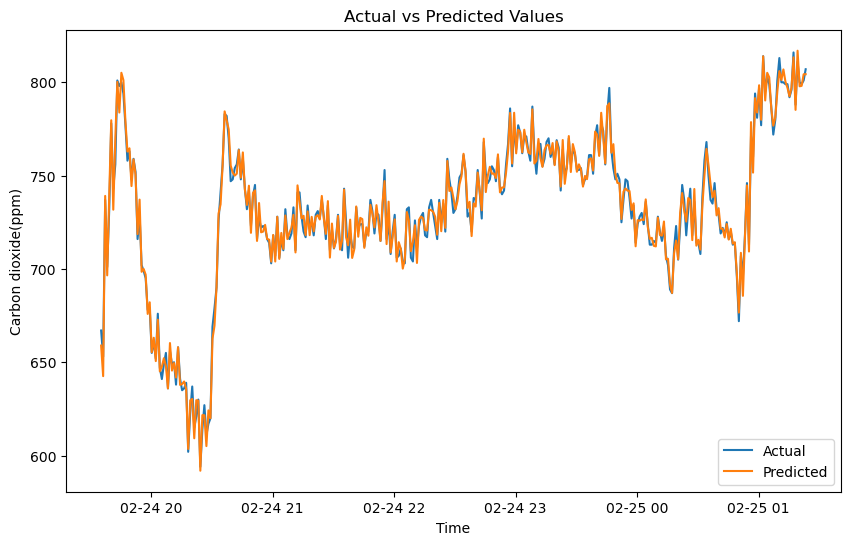

In [149]:
import matplotlib.pyplot as plt

# Plot the actual values
plt.figure(figsize=(10,6))
plt.plot(aranet4.loc[start_date:end_date, target], label='Actual')

# Plot the predicted values
plt.plot(predictions, label='Predicted')

plt.title('Actual vs Predicted Values')
plt.xlabel('Time')
plt.ylabel(target)
plt.legend()
plt.show()

You can evaluate the accuracy of the SARIMAX model's predictions by calculating error metrics such as Mean Absolute Error (MAE), Mean Squared Error (MSE), or Root Mean Squared Error (RMSE). 

Here's how you can calculate these metrics using scikit-learn:



In [150]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np

# Calculate the error metrics
mae = mean_absolute_error(aranet4.loc[start_date:end_date, target], predictions)
mse = mean_squared_error(aranet4.loc[start_date:end_date, target], predictions)
rmse = np.sqrt(mse)

print(f"Mean Absolute Error: {mae}")
print(f"Mean Squared Error: {mse}")
print(f"Root Mean Squared Error: {rmse}")

Mean Absolute Error: 3.288651084508035
Mean Squared Error: 17.38472509661098
Root Mean Squared Error: 4.169499382013503




These metrics provide a quantitative measure of the model's accuracy:

- MAE is the average of the absolute differences between the predicted and actual values. It gives an idea of how wrong the predictions were.
- MSE is similar to MAE, but squares the differences before averaging them. This makes larger errors more noticeable.
- RMSE is the square root of MSE. It's in the same units as the output, making it easier to interpret than MSE.

In addition to Mean Absolute Error (MAE), Mean Squared Error (MSE), and Root Mean Squared Error (RMSE), there are several other metrics that can be used to evaluate the accuracy of SARIMAX model predictions:

1. **Mean Absolute Percentage Error (MAPE)**: This is the mean of the absolute percentage differences between the predicted and actual values. It's useful when you want to understand the error in terms of the percentage of the actual value.



In [151]:
def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
mape = mean_absolute_percentage_error(aranet4.loc[start_date:end_date, target], predictions)
print(f"Mean Absolute Percentage Error: {mape}")

Mean Absolute Percentage Error: 0.4521992958501666




2. **Mean Squared Logarithmic Error (MSLE)**: This is similar to MSE, but it first takes the logarithm of the predicted and actual values. This can be useful when you care more about relative error than absolute error, particularly for exponential growth.



In [152]:
from sklearn.metrics import mean_squared_log_error

msle = mean_squared_log_error(aranet4.loc[start_date:end_date, target], predictions)
print(f"Mean Squared Logarithmic Error: {msle}")

Mean Squared Logarithmic Error: 3.298554274549133e-05




3. **R-squared (R^2)**: This is a statistical measure that represents the proportion of the variance for a dependent variable that's explained by an independent variable or variables in a regression model. It provides a measure of how well the model's predictions match the actual values.



In [153]:
from sklearn.metrics import r2_score
r2 = r2_score(aranet4.loc[start_date:end_date, target], predictions)
print(f"R-squared: {r2}")

R-squared: 0.9895295412000492


In [132]:
print("Dataset start: ", aranet4.index.min())
print("Dataset end: ", aranet4.index.max())
print("Prediction start: ", start_date)
print("Prediction end: ", end_date)

Dataset start:  2024-01-14 21:59:15
Dataset end:  2024-02-27 08:04:15
Prediction start:  2024-02-24 19:35:15
Prediction end:  2024-02-25 01:23:15


Visualizing the residuals of a SARIMAX model can provide valuable insights into the model's performance and the underlying data. Here are a few techniques:

1. **Residual Plot**: This is a simple scatter plot of the residuals (the difference between the actual and predicted values). Ideally, the points should be randomly scattered around zero.



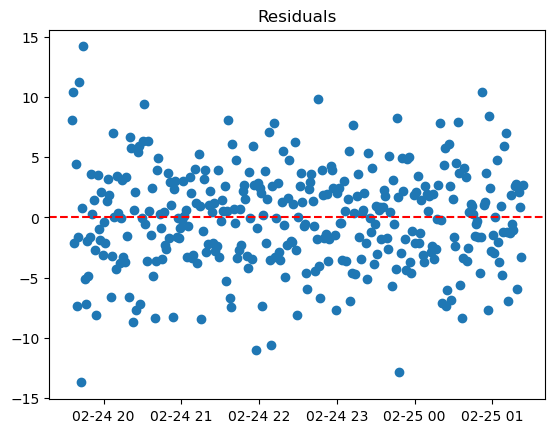

In [154]:
residuals = aranet4.loc[start_date:end_date, target] - predictions
plt.scatter(predictions.index, residuals)
plt.axhline(0, color='red', linestyle='--')  # Add a horizontal line at y=0
plt.title('Residuals')
plt.show()



2. **Histogram of Residuals**: This can give you an idea of the distribution of the residuals. Ideally, the residuals should be normally distributed around zero.



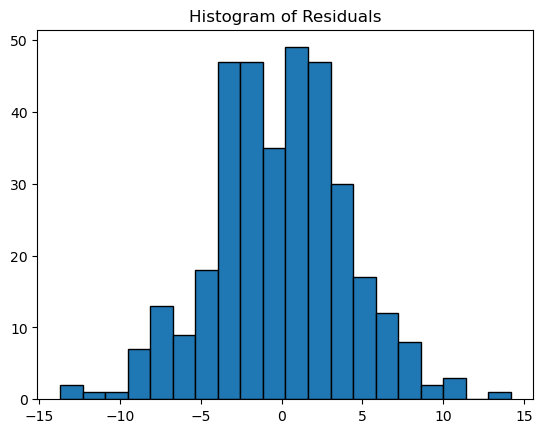

In [155]:
plt.hist(residuals, bins=20, edgecolor='black')
plt.title('Histogram of Residuals')
plt.show()



3. **Autocorrelation Plot**: This can show whether the residuals have any autocorrelation. If the model is working well, there should be no autocorrelation in the residuals.



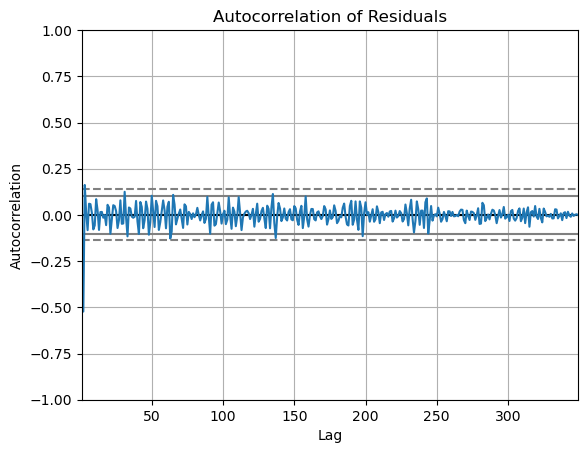

In [156]:
from pandas.plotting import autocorrelation_plot

autocorrelation_plot(residuals)
plt.title('Autocorrelation of Residuals')
plt.show()



4. **QQ Plot**: This can show whether the residuals are normally distributed. If the residuals are normally distributed, the points in the QQ plot will lie along the red line.



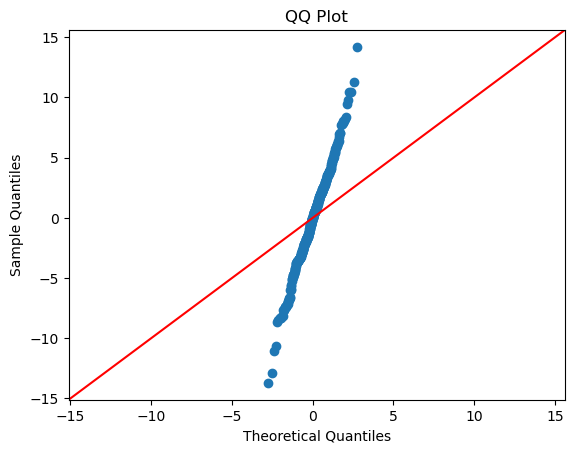

---------------------------------------------------------------------------
KeyError                                  Traceback (most recent call last)
File c:\Users\Corey Dearing\anaconda3\lib\site-packages\pandas\core\indexes\base.py:3629, in Index.get_loc(
    self=Index(['Carbon dioxide(ppm)', 'Temperature(°F)',...n', 'PeriodOfDay_Evening'],
      dtype='object'),
    key='Datetime',
    method=None,
    tolerance=None
)
   3628 try:
-> 3629     return self._engine.get_loc(casted_key)
        casted_key = 'Datetime'
        self = Index(['Carbon dioxide(ppm)', 'Temperature(°F)', 'Relative humidity(%)',
       'Atmospheric pressure(hPa)', 'Date', 'Time', 'CO2Quality', 'RHQuality',
       'Dew Point(°F)', 'Heat Index(°F)', 'AQI', 'CO2_diff', 'CO2_3min_avg',
       'CO2_5min_avg', 'CO2_10min_avg', 'CO2_15min_avg', 'CO2_30min_avg',
       'CO2_5min_rolling_diff', 'CO2_Level', 'DayOfWeek', 'DayOfWeekClass',
       'Carbon dioxide(ppm)_diff', 'Temperature(°F)_diff',
       'Relative humi

In [157]:
import statsmodels.api as sm

sm.qqplot(residuals, line='45')
plt.title('QQ Plot')
plt.show()



Remember to import the necessary libraries before using these techniques.

In [104]:
print(aranet4.dtypes)

Carbon dioxide(ppm)                     float64
Temperature(°F)                         float64
Relative humidity(%)                    float64
Atmospheric pressure(hPa)               float64
Date                                     object
Time                                     object
CO2Quality                               object
RHQuality                                object
Dew Point(°F)                           float64
Heat Index(°F)                          float64
AQI                                     float64
CO2_diff                                float64
CO2_3min_avg                            float64
CO2_5min_avg                            float64
CO2_10min_avg                           float64
CO2_15min_avg                           float64
CO2_30min_avg                           float64
CO2_5min_rolling_diff                   float64
CO2_Level                                object
DayOfWeek                               float64
DayOfWeekClass                          